<a href="https://colab.research.google.com/github/Ryd3n-c/TeamEWaste/blob/main/GIRec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Precision is a measure of, "when your model guesses how often does it guess correctly?" Recall is a measure of "has your model guessed every time that it should have guessed?" - aka. It does just not skip over the image


Mean Average Precision (mAP) is used to measure the performance of computer vision models. mAP is equal to the average of the Average Precision metric across all classes in a model.

Input Cells: Steps 2, 9, 12, 15

In [ ]:
# @title 1. Connecting to User's Google Drive
from google.colab import drive
drive.mount('/content/drive')


# importing tensorflow library
from keras.models import load_model  # TensorFlow is required for Keras to work
from PIL import Image, ImageOps  # Install pillow instead of PIL
import numpy as np

# Disable scientific notation for clarity
np.set_printoptions(suppress=True)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#@title  2.Inputting Image of Gastrointestinal Region
a = "/content/drive/MyDrive/Programs/Datasets/Shrubs.png"

In [ ]:
# @title 3. Classification and Confidence Score

# Load the model
model = load_model("/content/drive/MyDrive/Programs/Datasets/converted_keras (5)/keras_model.h5", compile=False)

# Load the labels
class_names = open("/content/drive/MyDrive/Programs/Datasets/converted_keras (5)/labels.txt", "r").readlines()

# Create the array of the right shape to feed into the keras model
# The 'length' or number of images you can put into the array is
# determined by the first position in the shape tuple, in this case 1
data = np.ndarray(shape=(1, 224, 224, 3), dtype=np.float32)

# Replace this with the path to your image
image = Image.open(a).convert("RGB")

# resizing the image to be at least 224x224 and then cropping from the center
size = (224, 224)
image = ImageOps.fit(image, size, Image.Resampling.LANCZOS)

# turn the image into a numpy array
image_array = np.asarray(image)

# Normalize the image
normalized_image_array = (image_array.astype(np.float32) / 127.5) - 1

# Load the image into the array
data[0] = normalized_image_array

# Predicts the model
prediction = model.predict(data)
index = np.argmax(prediction)
class_name = class_names[index]
confidence_score = prediction[0][index]

# Print prediction and confidence score
print("Class:", class_name[2:], end="")
print("Confidence Score:", confidence_score)


1/1 [==============================] - 3s 3s/step
Class: Polyp
Confidence Score: 0.99924976


In [ ]:
# @title 4. Leveraging Roboflow API
# Execute your desired code here.
!nvidia-smi
import os
HOME = os.getcwd()
print(HOME)

# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

# Git clone method (for development)

# %cd {HOME}
# !git clone github.com/ultralytics/ultralytics
# %cd {HOME}/ultralytics
# !pip install -e .

# from IPython import display
# display.clear_output()

# import ultralytics
# ultralytics.checks()

from ultralytics import YOLO

from IPython.display import display, Image

from google.colab import drive
drive.mount('/content/drive')

!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="7v4vrO2RmcfhHF0pFiUA")
project = rf.workspace("ryd3n").project("test-lm2ej")
dataset = project.version(10).download("yolov8")
#While your deployment is processing, checkout the deployment docs to take your model to most destinations https://docs.roboflow.com/inference


Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 31.7/201.2 GB disk)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.1/74.1 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 35.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.8 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  At

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to test-10 in yolov8:: 100%|██████████| 6000/6000 [00:00<00:00, 7380.89it/s]


loading Roboflow workspace...
loading Roboflow project...


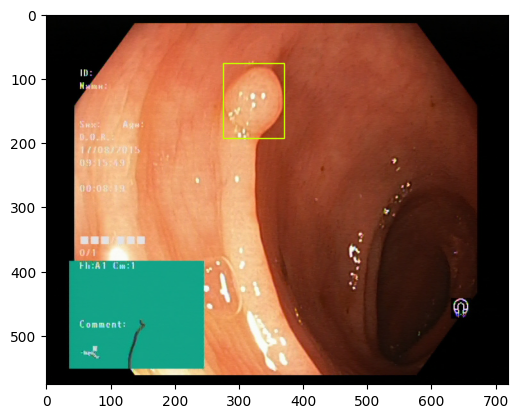

{'predictions': [{'x': 322,
   'y': 133,
   'width': 95,
   'height': 116,
   'confidence': 0.8977648615837097,
   'class': 'polyp',
   'class_id': 0,
   'detection_id': 'cf8f8453-555f-4ab2-b666-3d9b61ea09ef',
   'image_path': '/content/drive/MyDrive/Programs/Datasets/test/polyp/test_polyps_ (62).jpg',
   'prediction_type': 'ObjectDetectionModel'}],
 'image': {'width': '720', 'height': '576'}}

In [ ]:
# @title 5. Polyp Detection
project = rf.workspace().project("test-lm2ej")
model = project.version("3").model

# optionally, change the confidence and overlap thresholds
# values are percentages
model.confidence = 50
model.overlap = 25

prediction = model.predict(a)
# Plot the prediction in an interactive environment
prediction.plot()

# Convert predictions to JSON
prediction.json()

In [ ]:
# @title 6. Installing Dense Prediction Transformer Model
!pip install transformers
from transformers import DPTImageProcessor, DPTForDepthEstimation

import torch
import numpy as np
from PIL import Image
import requests

image = Image.open(a)

processor = DPTImageProcessor.from_pretrained("Intel/dpt-large")
model = DPTForDepthEstimation.from_pretrained("Intel/dpt-large")

# prepare image for the model
inputs = processor(images=image, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=image.size[::-1],
     mode="bicubic",
     align_corners=False,
)

# visualize the prediction
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/285 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/942 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.37G [00:00<?, ?B/s]

Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution1.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution1.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


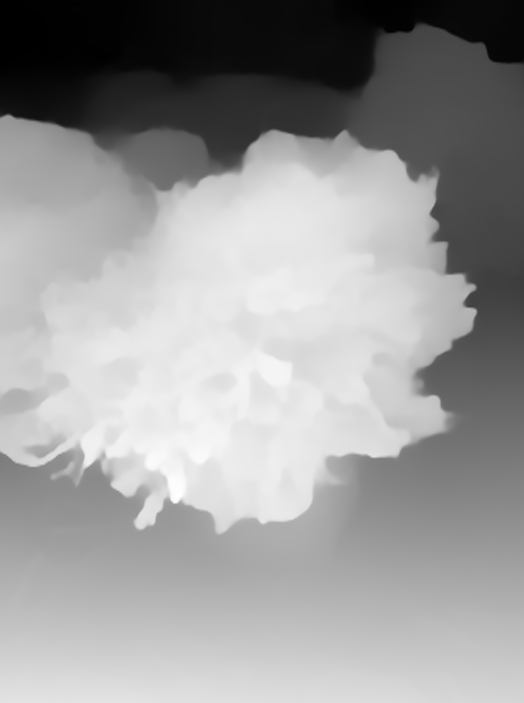

In [ ]:
#@title 7. Generating Depth Map (+ saving image to google drive)
#!pip install transformers
#!pip install Pillow
#from PIL import Image
#from io import BytesIO
from transformers import pipeline
pipe = pipeline(task="depth-estimation", model="Intel/dpt-large")
result = pipe(a)
result["depth"]



In [ ]:
#@title 8. Installing Open3D
!pip install open3d

import open3d as o3d
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
#monkey patches visualization and provides helpers to load geometries
sys.path.append('..')


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 102.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 20.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 90.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 88.6 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


In [ ]:
#@title 9. Inputting Depth Map
depth_raw = o3d.io.read_image("/content/drive/MyDrive/Programs/Datasets/image.png") #Put file location (Google Drive) of depth map

In [ ]:
import open3d as o3d
import matplotlib.pyplot as plt
import numpy as np
import os
import sys
#monkey patches visualization and provides helpers to load geometries
sys.path.append('..')
#@title 10. Showing Input Images
print("Read Redwood dataset")
color_raw = o3d.io.read_image(a)
rgbd_image = o3d.geometry.RGBDImage.create_from_color_and_depth(
    color_raw, depth_raw)
print(rgbd_image)

plt.subplot(1, 2, 1)
plt.title("Redwood grayscale image")
plt.imshow(rgbd_image.color)
plt.subplot(1, 2, 2)
plt.title("Redwood depth image")
plt.imshow(rgbd_image.depth)
plt.show

Read Redwood dataset


RuntimeError: [1;31m[Open3D Error] (static std::shared_ptr<open3d::geometry::RGBDImage> open3d::geometry::RGBDImage::CreateFromColorAndDepth(const open3d::geometry::Image&, const open3d::geometry::Image&, double, double, bool)) /root/Open3D/cpp/open3d/geometry/RGBDImageFactory.cpp:23: RGB image size (703 524) and depth image size (711 533) mismatch.
[0;m

In [ ]:
#@title 11. Creating a 3D Point Cloud
pcd = o3d.geometry.PointCloud.create_from_rgbd_image(
    rgbd_image,
    o3d.camera.PinholeCameraIntrinsic(
        o3d.camera.PinholeCameraIntrinsicParameters.PrimeSenseDefault))
#Flip it, otherwise the pointcloud will be upside down
pcd.transform([[1, 0, 0, 0], [0, -1, 0, 0], [0, 0, -1, 0], [0, 0, 0, 1]])
print(pcd)
print(np.asarray(pcd.points))

NameError: name 'rgbd_image' is not defined

In [ ]:
#@title 12. Writing Point Cloud to Google Drive (creating a custom name)
o3d.io.write_point_cloud("/content/drive/MyDrive/Programs/Datasets/11testing6.ply", pcd)

True

In [ ]:
#@title 13. Downsampling
# Downsample the point cloud
downsampled_pcd = pcd.voxel_down_sample(voxel_size=0.0000032111111)
#voxel_size=0.0000028111111 gives PointCloud with 78862 points.

  # Adjust the voxel_size as needed


# Print the downsampled point cloud and its coordinates
print(downsampled_pcd)
print(np.asarray(downsampled_pcd.points))


# Calculate the target number of points
target_num_points = 500000

# Calculate the voxel size to achieve the target number of points
voxel_size = (np.asarray(pcd.points).shape[0] / target_num_points) ** (1/3)

# Downsample the point cloud with the calculated voxel size
downsampled_pcd = pcd.voxel_down_sample(voxel_size=voxel_size)

PointCloud with 96623 points.
[[ 0.00052222 -0.00043856 -0.00068627]
 [ 0.00051798 -0.00044107  -0.0006902]
 [  0.0005114 -0.00044107  -0.0006902]
 ...
 [ 0.00013235 -0.00037584 -0.00068235]
 [ 0.00052036  0.00021864 -0.00077647]
 [ 0.00013907  -0.0003564 -0.00064706]]


In [ ]:
#@title 14. Writing Downsampled 3D Point Cloud to Google Drive (creating a custom name)
# Write downsampled point cloud to PLY file
o3d.io.write_point_cloud("/content/drive/MyDrive/Programs/Datasets/downsampled_2pointcloud126.ply", downsampled_pcd)
print("Load a ply point cloud, print it, and render it")
ply_point_cloud = o3d.data.PLYPointCloud()

points = np.asarray(pcd.points)
# Visualize the point cloud

Load a ply point cloud, print it, and render it
[Open3D INFO] Downloading https://github.com/isl-org/open3d_downloads/releases/download/20220201-data/fragment.ply
[Open3D INFO] Downloaded to /root/open3d_data/download/PLYPointCloud/fragment.ply


In [ ]:
#@title 15. Inputting Point Cloud
pcd = o3d.io.read_point_cloud('/content/drive/MyDrive/Programs/Datasets/downsampled_pointcloud21.ply')

In [ ]:
#@title 16. Viewing 3D Point Cloud with Plotly
import numpy as np
import plotly.graph_objects as go


colors = None
if pcd.has_colors():
    colors = np.asarray(pcd.colors)
elif pcd.has_normals():
    colors = (0.5, 0.5, 0.5) + np.asarray(pcd.normals) * 0.5



fig = go.Figure(
  data=[
    go.Scatter3d(
      x=points[:,0], y=points[:,1], z=points[:,2],
      mode='markers',
      marker=dict(size=1, color=colors)
)
],
  layout=dict(
    scene=dict(
      xaxis=dict(visible=False),
      yaxis=dict(visible=False),
      zaxis=dict(visible=False)
)
)
)
fig.show()

In [ ]:
#@title 17. Viewing 3D Point Cloud with Plotly (Continued)
dataset = o3d.data.DemoICPPointClouds()
source = o3d.io.read_point_cloud('/content/drive/MyDrive/Programs/Datasets/downsampled_pointcloud21.ply')
o3d.visualization.draw_plotly([source])

[Open3D INFO] Downloading https://github.com/isl-org/open3d_downloads/releases/download/20220301-data/DemoICPPointClouds.zip
[Open3D INFO] Downloaded to /root/open3d_data/download/DemoICPPointClouds/DemoICPPointClouds.zip
[Open3D INFO] Created directory /root/open3d_data/extract/DemoICPPointClouds.
[Open3D INFO] Extracting /root/open3d_data/download/DemoICPPointClouds/DemoICPPointClouds.zip.
[Open3D INFO] Extracted to /root/open3d_data/extract/DemoICPPointClouds.
